In [462]:
############################################

# OS환경 : Mac OS

############################################ 초기셋팅
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager, rc
import platform
import matplotlib

import warnings
warnings.filterwarnings('ignore')

############################################ 여기서 Matplotlib 코드를 사용하여 그래프 생성 및 표시
%matplotlib inline

############################################ 시각화 셋팅 
import matplotlib.font_manager as fm
import matplotlib.pyplot as plt
## 폰트 설정 및 마이너스 부호 설정
plt.rc('font', family='NanumSquare') #나눔 글꼴로 설정
#plt.rc('font', family='Malgun Gothic') #맑은 고딕으로 설정
plt.rc('font', family='AppleGothic') #맥
plt.rcParams['axes.unicode_minus'] = False #부호

# ############################################ 지도 시각화 라이브러리 Folium 설치 및 불러오기
# # !pip install folium
import folium

In [463]:
# 기본 좌표 설정 (구글맵 등을 통해 위도/경도 확인) 

# 위도
latitude = 37.40892

# 경도
longitude = 126.9130

# Map 코드입력
m = folium.Map(
    location=[latitude, longitude],    # 위도, 경도 
    zoom_start = 16,                   # 확대 범위 (최대 18까지)
    weight = 750,                      # 지도 가로 
    height=500,                        # 지도 세로 
)
m

In [464]:
# 마커 추가 코드 
folium.Marker(
    [latitude, longitude],    # 위도, 경도 
    popup='우리동네',           # 팝업문구 (마우스 클릭시)
    tooltip='살기 좋은 석수동'    # 표기툴팁 (마우스 갖다대면)
    ).add_to(m)               # 위의 지도 m에 해당내용을 추가

m

In [465]:
# 위의 마커 스타일 변경 

folium.Marker(
    [latitude, longitude],   
    popup='우리동네',          
    tooltip='살기 좋은 석수동',    

    icon=folium.Icon('orange',icon='star') ,      ################## 해당코드추가 --> 참고로 I대문자임 
    
    ).add_to(m)                  

m

In [466]:
# 마커(popup 또는 tooltip)에 html코드(이미지 또는 유투브영상등) 삽입 
# 유투브의경우 Share퍼가기 -> Embed 에 있는 코드 그대로 copy

folium.Marker(
    [latitude, longitude],    # 위도, 경도 
    popup='<iframe width="560" height="315" src="https://www.youtube.com/embed/1O48L9M21IM?si=r_m8nYnFMF3iAh-L" title="YouTube video player" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture; web-share" allowfullscreen></iframe>',
    tooltip='살기 좋은 석수동'    # 표기툴팁 (마우스 갖다대면)
    ).add_to(m)               # 위의 지도 m에 해당내용을 추가

m

In [467]:
# 동그라미 추가

folium.CircleMarker(
    [latitude, longitude], 
    color='tomato', 
    radius=50, 
    tooltip='우리동네'
).add_to(m)
m

# 소상공인시장진흥공단 상가(상권)정보

In [468]:
df = pd.read_csv('./learn/data20230930/소상공인시장진흥공단_상가(상권)정보_경기_202309.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 560036 entries, 0 to 560035
Data columns (total 39 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   상가업소번호     560036 non-null  object 
 1   상호명        560036 non-null  object 
 2   지점명        8773 non-null    object 
 3   상권업종대분류코드  560036 non-null  object 
 4   상권업종대분류명   560036 non-null  object 
 5   상권업종중분류코드  560036 non-null  object 
 6   상권업종중분류명   560036 non-null  object 
 7   상권업종소분류코드  560036 non-null  object 
 8   상권업종소분류명   560036 non-null  object 
 9   표준산업분류코드   559967 non-null  object 
 10  표준산업분류명    559967 non-null  object 
 11  시도코드       560036 non-null  int64  
 12  시도명        560036 non-null  object 
 13  시군구코드      560036 non-null  int64  
 14  시군구명       560036 non-null  object 
 15  행정동코드      560036 non-null  int64  
 16  행정동명       560036 non-null  object 
 17  법정동코드      560036 non-null  int64  
 18  법정동명       560036 non-null  object 
 19  지번코드       560036 non-n

In [469]:
df.head()

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA0101202210A0082752,엠마스키친,NaN,I2,음식,I204,서양식,I20401,경양식,I56123,...,4146510600105160003000002,NaN,경기도 용인시 수지구 성복2로 270,448831,16806,NaN,NaN,NaN,127.058229,37.319164
1,MA0101202210A0004063,팽성농산물센터,NaN,G2,소매,G205,식료품 소매,G20506,채소/과일 소매업,G47215,...,4122025039100930001033303,NaN,경기도 평택시 팽성읍 석근2길 36,451803,17997,NaN,NaN,NaN,127.048075,36.936336
2,MA0101202210A0089792,역전할머니맥주평택궁리점,NaN,I2,음식,I211,주점,I21103,생맥주 전문,I56213,...,4122033026100720011024544,NaN,경기도 평택시 고덕면 궁2길 67,451841,17821,NaN,NaN,NaN,127.034381,37.018039
3,MA0101202210A0101847,지제역부동산마트공인중개사사무소,NaN,L1,부동산,L102,부동산 서비스,L10203,부동산 중개/대리업,L68221,...,4122011900100000000000107,NaN,경기도 평택시 지제동삭2로 181-24,450802,18029,NaN,1,NaN,127.093832,37.016832
4,MA0101202210A0050965,혜윰건축사사무소,NaN,M1,과학·기술,M109,기술 서비스,M10901,건축 설계 및 관련 서비스업,M72111,...,4127110100106240012004645,고요한정원,경기도 안산시 상록구 웃말5길 9-1,426860,15328,NaN,NaN,NaN,126.871046,37.306182


In [470]:
pd.Series(df.columns)

0        상가업소번호
1           상호명
2           지점명
3     상권업종대분류코드
4      상권업종대분류명
5     상권업종중분류코드
6      상권업종중분류명
7     상권업종소분류코드
8      상권업종소분류명
9      표준산업분류코드
10      표준산업분류명
11         시도코드
12          시도명
13        시군구코드
14         시군구명
15        행정동코드
16         행정동명
17        법정동코드
18         법정동명
19         지번코드
20       대지구분코드
21        대지구분명
22        지번본번지
23        지번부번지
24         지번주소
25        도로명코드
26          도로명
27        건물본번지
28        건물부번지
29       건물관리번호
30          건물명
31        도로명주소
32        구우편번호
33        신우편번호
34          동정보
35          층정보
36          호정보
37           경도
38           위도
dtype: object

In [471]:
# 일부지역만 발췌 
sub_df = df.loc[df['법정동명'].isin(['석수동','박달동','안양동'])]
sub_df.info()
sub_df.head(2)

<class 'pandas.core.frame.DataFrame'>
Index: 9686 entries, 18 to 559985
Data columns (total 39 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   상가업소번호     9686 non-null   object 
 1   상호명        9686 non-null   object 
 2   지점명        125 non-null    object 
 3   상권업종대분류코드  9686 non-null   object 
 4   상권업종대분류명   9686 non-null   object 
 5   상권업종중분류코드  9686 non-null   object 
 6   상권업종중분류명   9686 non-null   object 
 7   상권업종소분류코드  9686 non-null   object 
 8   상권업종소분류명   9686 non-null   object 
 9   표준산업분류코드   9685 non-null   object 
 10  표준산업분류명    9685 non-null   object 
 11  시도코드       9686 non-null   int64  
 12  시도명        9686 non-null   object 
 13  시군구코드      9686 non-null   int64  
 14  시군구명       9686 non-null   object 
 15  행정동코드      9686 non-null   int64  
 16  행정동명       9686 non-null   object 
 17  법정동코드      9686 non-null   int64  
 18  법정동명       9686 non-null   object 
 19  지번코드       9686 non-null   int64  
 20  대지구분코드    

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
18,MA010120220805430833,두메골민속주점,NaN,I2,음식,I211,주점,I21104,요리 주점,I56219,...,4117110100106380004007968,NaN,경기도 안양시 만안구 만안로 214,430831,13992,NaN,1,NaN,126.923798,37.399898
208,MA010120220805434652,설레임분식,NaN,I2,음식,I210,기타 간이,I21007,김밥/만두/분식,I56194,...,4117110100101550002021116,한승미메이드아파트,경기도 안양시 만안구 태평로60번길 16,430816,14037,NaN,1,NaN,126.929901,37.395628


In [472]:
# 필요컬럼만 발췌 
sub_df[['위도','경도','상호명']]

,위도,경도,상호명
18,37.399898,126.923798,두메골민속주점
208,37.395628,126.929901,설레임분식
221,37.399563,126.923566,이차돌
252,37.419677,126.923876,해은통신
307,37.392884,126.938297,릴리제이
...,...,...,...
559841,37.391724,126.934542,퀸점핑앤온열
559846,37.387759,126.923621,비비큐안양씨엘포레
559892,37.399158,126.920714,호이호떡
559920,37.399870,126.921698,"셀프사진관예뻐서,봄"


In [473]:
# 클러스터 생성 
from folium.plugins import MarkerCluster 

m = folium.Map(                         # 새로운 Map 작성 
    location=[latitude, longitude], 
    zoom_start=16
)

coords = sub_df[['위도','경도']]   # 위도,경도에 해당하는 값만 

In [474]:
# 클러스터링 코드  
marker_cluster = MarkerCluster().add_to(m)

# 위도,경도를 반복문으로 상권들을 묶어주기 
for lat, lng in zip(coords['위도'], coords['경도']):  
    folium.Marker([lat, lng], icon=folium.Icon(color='green')).add_to(marker_cluster)

# 클러스터링 해서 보여줌 = 상권을 묶어서 보여줌 
m    

# 서울시 행정구역별 

In [475]:
import requests
import json

# 서울 행정구역 json raw파일(githubcontent)
r = requests.get('https://raw.githubusercontent.com/southkorea/seoul-maps/master/kostat/2013/json/seoul_municipalities_geo_simple.json')
c = r.content
seoul_geo = json.loads(c)
                              # 각 구마다 어떻게 구성이 되어있는지 json형태로 확인가능, 
#seoul_geo                    # 일단 너무 길어서 주석처리함 

In [476]:
# 서울시 구별 바운더리 시각화 
m = folium.Map(
    location=[37.52408, 126.9802],     # 일단 서울시 용산구의 국립중앙박물관 경도,위도
    zoom_start=11,
)
 
folium.GeoJson(seoul_geo, name='지역구').add_to(m)
               #--------Json파일
      
m              # 바운더리 기준으로 표시됨

In [477]:
# 위의 지도 테마 변경   

m = folium.Map(
    location=[37.52408, 126.9802],     
    zoom_start=11,
    
    tiles='cartodbpositron',       # 타일변경 'CartoDB positron' 해도 똑같음 
)
 
folium.GeoJson(seoul_geo, name='지역구').add_to(m)
m

# 서울시 상권정보 데이터 
소상공인시장진흥공단 상권 정보 데이터셋 

In [478]:
# 서울시 데이터 불러오기 
seoul = pd.read_csv('./learn/data20230930/소상공인시장진흥공단_상가(상권)정보_서울_202309.csv')

# 컬럼 확인 
print(seoul.columns)

# 필요 컬럼만 발췌 
seoul = seoul[['시군구명','상권업종대분류명','상권업종중분류명','위도','경도']]
seoul

Index(['상가업소번호', '상호명', '지점명', '상권업종대분류코드', '상권업종대분류명', '상권업종중분류코드',
       '상권업종중분류명', '상권업종소분류코드', '상권업종소분류명', '표준산업분류코드', '표준산업분류명', '시도코드',
       '시도명', '시군구코드', '시군구명', '행정동코드', '행정동명', '법정동코드', '법정동명', '지번코드',
       '대지구분코드', '대지구분명', '지번본번지', '지번부번지', '지번주소', '도로명코드', '도로명', '건물본번지',
       '건물부번지', '건물관리번호', '건물명', '도로명주소', '구우편번호', '신우편번호', '동정보', '층정보',
       '호정보', '경도', '위도'],
      dtype='object')


,시군구명,상권업종대분류명,상권업종중분류명,위도,경도
0,광진구,음식,한식,37.568503,127.082832
1,중구,숙박,일반 숙박,37.565708,127.005849
2,노원구,교육,기타 교육,37.649226,127.076956
3,양천구,과학·기술,사진 촬영,37.542117,126.828832
4,강서구,음식,한식,37.560053,126.833022
...,...,...,...,...,...
482954,강남구,음식,기타 간이,37.484681,127.044554
482955,관악구,음식,기타 간이,37.486279,126.940403
482956,구로구,음식,기타 간이,37.490225,126.890242
482957,송파구,소매,종합 소매,37.534453,127.116063


In [479]:
# 서울시 업종별('상권업종중분류명') 갯수

seoul.상권업종중분류명.value_counts() # 많은 순에서부터 내림차순 

상권업종중분류명
한식             47503
이용·미용          28267
기타 간이          28053
섬유·의복·신발 소매    27407
부동산 서비스        24970
               ...  
병원               369
장례식장             327
통신장비 수리          300
조경·유지            107
기타 외국             47
Name: count, Length: 75, dtype: int64

In [480]:
# 서울시 업종별('상권업종중분류명') 내림차순정렬에서 업종명만 발췌

seoul.상권업종중분류명.value_counts().index

Index(['한식', '이용·미용', '기타 간이', '섬유·의복·신발 소매', '부동산 서비스', '비알코올 ', '본사·경영 컨설팅',
       '종합 소매', '주점', '광고', '기타 교육', '전문 디자인', '의약·화장품 소매', '기술 서비스', '유원지·오락',
       '식료품 소매', '법무관련 ', '스포츠 서비스', '의원', '가전·통신 소매', '일반 교육', '서양식', '일식',
       '회계·세무', '사진 촬영', '중식', '여행사·보조', '오락용품 소매', '자동차 수리·세차', '세탁',
       '인쇄·제품제작', '교육 지원', '청소·방제', '기타 사업 서비스', '일반 숙박', '기타 생활용품 소매',
       '기타 가정용품 수리', '철물·건설자재 소매', '고용 알선', '기타 숙박', '안경·정밀기기 소매', '장식품 소매',
       '시계·귀금속 소매', '도서관·사적지', '욕탕·신체관리', '기타 전문 과학', '식물 소매', '가전제품 수리',
       '컴퓨터 수리', '동남아시아', '가정용품 대여', '애완동물·용품 소매', '중고 상품 소매', '가구 소매',
       '산업용품 대여', '시설관리', '기타 상품 소매', '구내식당·뷔페', '사무 지원', '연료 소매', '수의',
       '자동차 부품 소매', '음료 소매', '담배 소매', '시장 조사', '운송장비 대여', '기타 개인', '모터사이클 수리',
       '기타 보건', '모터사이클 소매', '병원', '장례식장 ', '통신장비 수리', '조경·유지', '기타 외국'],
      dtype='object', name='상권업종중분류명')

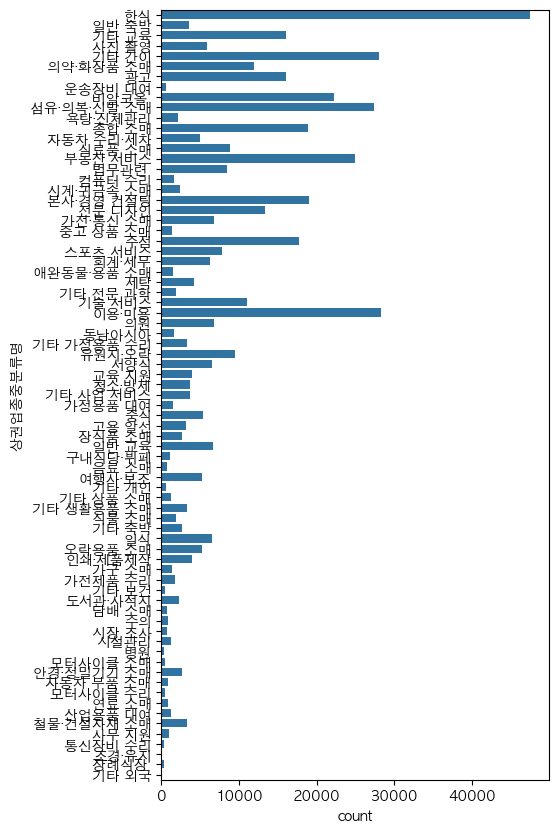

In [481]:
# 서울시 업종별('상권업종중분류명') 갯수 시각화 

plt.figure(figsize=(5,10))
sns.countplot(y=seoul.상권업종중분류명);

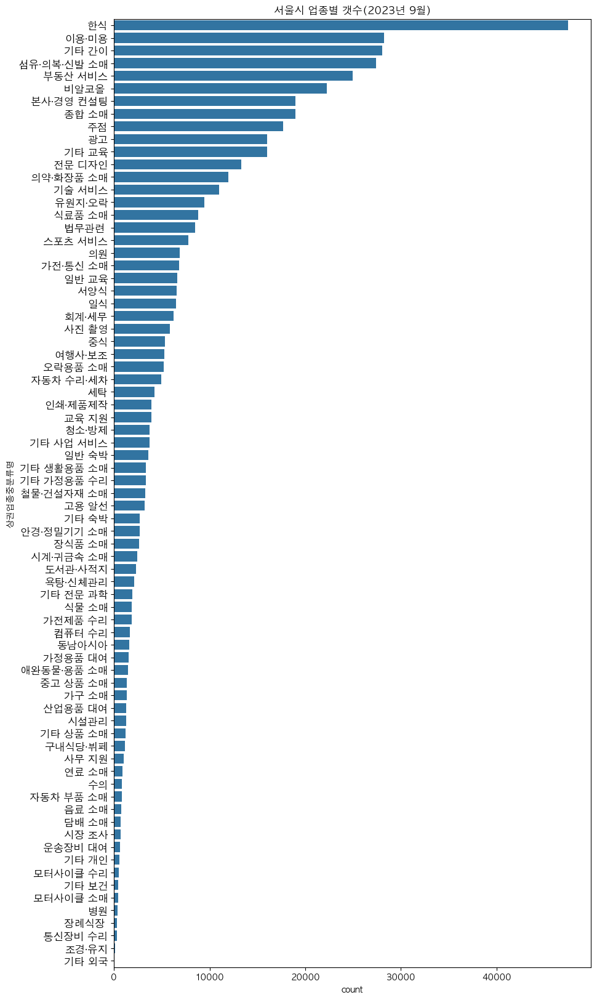

In [482]:
# 서울시 업종별('상권업종중분류명') 갯수 시각화 --> 내림차순 

plt.figure(figsize=(10,20))
plt.yticks(fontsize=12)
plt.title('서울시 업종별 갯수(2023년 9월)')
sns.countplot(y=seoul.상권업종중분류명, order=seoul.상권업종중분류명.value_counts().index);

In [483]:
# 상권업종중분류명 컬럼의 앞뒤 공백 제거
seoul['상권업종중분류명'] = seoul['상권업종중분류명'].str.strip()
# '비알코올 ' --> '비알코올'

# 커피/카페 업종('비알코올')만 발췌 
seoul.loc[seoul['상권업종중분류명'] == '비알코올']

,시군구명,상권업종대분류명,상권업종중분류명,위도,경도
10,금천구,음식,비알코올,37.446689,126.909939
33,송파구,음식,비알코올,37.484021,127.120954
78,동대문구,음식,비알코올,37.598493,127.056962
80,강동구,음식,비알코올,37.530474,127.125070
108,강남구,음식,비알코올,37.516746,127.040820
...,...,...,...,...,...
482855,강동구,음식,비알코올,37.557124,127.164396
482889,중구,음식,비알코올,37.565343,127.002050
482898,광진구,음식,비알코올,37.542865,127.068639
482901,양천구,음식,비알코올,37.546391,126.866052


In [484]:
# 커피/카페 업종('비알코올')만 발췌 후, 자치구별 비교 
seoul.loc[seoul['상권업종중분류명'] == '비알코올'].groupby('시군구명')['상권업종대분류명'].count()

시군구명
강남구     2083
강동구      725
강북구      511
강서구     1025
관악구      808
광진구      807
구로구      601
금천구      556
노원구      659
도봉구      390
동대문구     696
동작구      614
마포구     1968
서대문구     687
서초구     1203
성동구      800
성북구      808
송파구     1400
양천구      574
영등포구    1128
용산구      824
은평구      660
종로구     1215
중구      1009
중랑구      538
Name: 상권업종대분류명, dtype: int64

In [485]:
# 커피/카페 업종('비알코올')만 발췌 후, 자치구별 '오름차순'비교 
seoul.loc[seoul['상권업종중분류명'] == '비알코올'].groupby('시군구명')['상권업종대분류명'].count().sort_values()

시군구명
도봉구      390
강북구      511
중랑구      538
금천구      556
양천구      574
구로구      601
동작구      614
노원구      659
은평구      660
서대문구     687
동대문구     696
강동구      725
성동구      800
광진구      807
관악구      808
성북구      808
용산구      824
중구      1009
강서구     1025
영등포구    1128
서초구     1203
종로구     1215
송파구     1400
마포구     1968
강남구     2083
Name: 상권업종대분류명, dtype: int64

<Axes: xlabel='시군구명'>

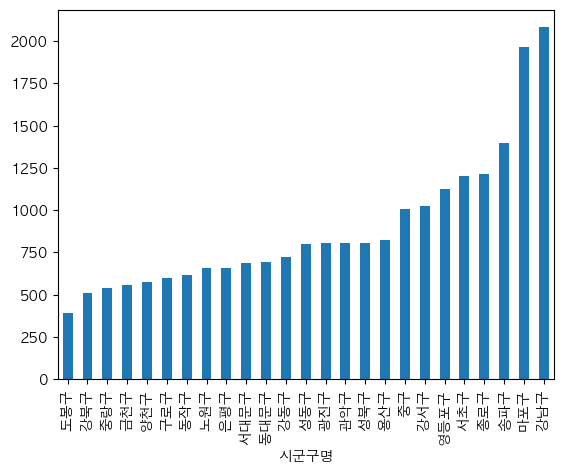

In [486]:
# 커피/카페 업종('비알코올')만 발췌 후, 자치구별 '오름차순'비교 시각화 
seoul.loc[seoul['상권업종중분류명'] == '비알코올'].groupby('시군구명')['상권업종대분류명'].count().sort_values().plot(kind='bar')

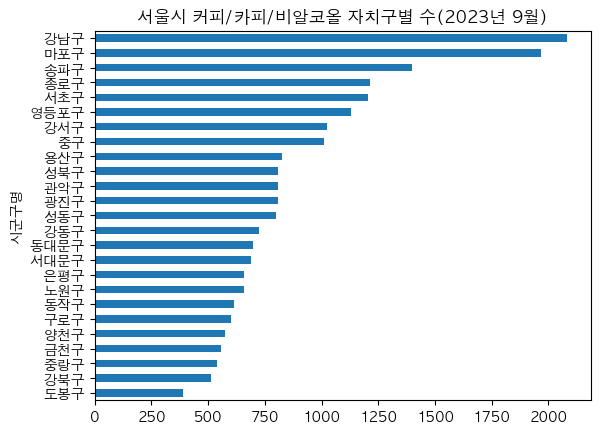

In [487]:
# 커피/카페 업종('비알코올')만 발췌 후, 자치구별 '오름차순'비교 시각화 

plt.title('서울시 커피/카피/비알코올 자치구별 수(2023년 9월)')
seoul.loc[seoul['상권업종중분류명'] == '비알코올'].groupby('시군구명')['상권업종대분류명'].count().sort_values().plot(kind='barh');

In [488]:
# 지도 생성 
m = folium.Map(
    location=[37.52408, 126.9802], 
    zoom_start=11, 
    tiles='cartodbpositron',
)

folium.GeoJson(
    seoul_geo,
    name='지역구'
).add_to(m)

# m

In [489]:
# 클러스터 추가 
marker_cluster = MarkerCluster().add_to(m)

# 서울시 커피/카페/비알코올 데이터만 발췌 
seoul_coffee = seoul.loc[seoul['상권업종중분류명'] == '비알코올']

# 그 중 위도와 경도만 발췌하여 반복문으로 묶어서, 클러스터에 추가 
for lat, lng in zip(seoul_coffee['위도'],seoul_coffee['경도']): 
    folium.Marker([lat,lng], icon=folium.Icon(color='red')).add_to(marker_cluster)

m    

In [490]:
# 서울시 자치구별로 '비알코올'인 업종 갯수 확인

seoul_group_data = seoul.loc[seoul['상권업종중분류명']=='비알코올'].groupby('시군구명')['상권업종중분류명'].count()
seoul_group_data

시군구명
강남구     2083
강동구      725
강북구      511
강서구     1025
관악구      808
광진구      807
구로구      601
금천구      556
노원구      659
도봉구      390
동대문구     696
동작구      614
마포구     1968
서대문구     687
서초구     1203
성동구      800
성북구      808
송파구     1400
양천구      574
영등포구    1128
용산구      824
은평구      660
종로구     1215
중구      1009
중랑구      538
Name: 상권업종중분류명, dtype: int64

In [491]:
# 서울시 자치구별로 '비알코올'인 업종 갯수에 따른 색상차이 맵시각화 

m = folium.Map(                            # 지도 셋팅 
    location=[37.52408, 126.9802], 
    zoom_start=11, 
    tiles='cartodbpositron'
)
                                           # Json파일(서울시 자치구별 위도,경도 데이터 추가) 
folium.GeoJson(
    seoul_geo, 
    name='지역구', 
).add_to(m)

m

In [492]:
# seoul_geo

# 길어서 주석처리함 
# {'type': 'FeatureCollection',
#  'features': [{'type': 'Feature',
#    'properties': {'code': '11250',          # 프로퍼티 값 
#     'name': '강동구',
#     'name_eng': 'Gangdong-gu',
#     'base_year': '2013'},
#    'geometry': {'type': 'Polygon',
#     'coordinates': [[[127.11519584981606, 37.557533180704915],
#       [127.11879551821994, 37.557222485451305],
#       [127.12146867175024, 37.55986003393365],
#       [127.12435254630417, 37.56144246249796],
#       [127.13593925898998, 37.56564793048277],
#       [127.14930548011061, 37.56892250303897],
#       [127.15511020940411, 37.57093642128295],
#       [127.16683184366129, 37.57672487388627],   이런식으로 되어있음 

In [493]:
# 서울시 행정구역 데이터 seoul_geo 가져와서 대입하기 

folium.Choropleth(
    geo_data=seoul_geo,            # 서울시 행정구역 표기된 json데이터 
    data = seoul_group_data,       # 서울시 자치구별 '비알코올' 업종 갯수
    fill_color='YlOrRd', 
    fill_opacity=0.5,              # 투명도 1짙음, 0흐림 
    line_opacity=0.2, 
    key_on = 'properties.name',    # seoul_geo의 properties 이름 지정 (다른 json파일에서는 properties가 아닐수 있으니 주의)
    legend_name = '지역구별 카페 업종 수'
).add_to(m)
m

In [494]:
list(seoul_group_data.quantile([0, 0.25, 0.5, 0.75, 1 ]))    # 퍼센트로 4구간 나누어줌 

[390.0, 614.0, 800.0, 1025.0, 2083.0]

In [495]:
# 위처럼 균등분할이 아닌, 4구간으로 나누어 퍼센트로 시각화 
bins = list(seoul_group_data.quantile([0, 0.25, 0.5, 0.75, 1 ]))

m = folium.Map(                            # 지도 셋팅 
    location=[37.52408, 126.9802], 
    zoom_start=11, 
    tiles='cartodbpositron'
)
                                           # Json파일(서울시 자치구별 위도,경도 데이터 추가) 
folium.GeoJson(
    seoul_geo, 
    name='지역구', 
).add_to(m)    

folium.Choropleth(
    geo_data=seoul_geo,            # 서울시 행정구역 표기된 json데이터 
    data = seoul_group_data,       # 서울시 자치구별 '비알코올' 업종 갯수
    fill_color='YlOrRd', 
    fill_opacity=0.5,              # 투명도 1짙음, 0흐림 
    line_opacity=0.2, 
    key_on = 'properties.name',    # seoul_geo의 properties 이름 지정 (다른 json파일에서는 properties가 아닐수 있으니 주의)
    legend_name = '지역구별 카페 업종 수', 

    bins = bins 
    
).add_to(m)
m

In [496]:
# HTML 파일로 저장 

m.save('map.html')